In [1]:
import os
import sys
#sys.path.append(os.path.join(os.getcwd(), '..'))
from ldm.data.deepfashion import DeepFashionSMPL
#from ldm.util import instantiate_from_config
from einops import rearrange
import matplotlib.pyplot as plt
from collections import namedtuple
from copy import deepcopy

import argparse, os, sys, glob
import torch
import numpy as np
from omegaconf import OmegaConf
from PIL import Image
from tqdm import tqdm, trange
from itertools import islice
from einops import rearrange
from torchvision.utils import make_grid
import time
from pytorch_lightning import seed_everything
from torch import autocast
from contextlib import contextmanager, nullcontext

from ldm.util import instantiate_from_config
from ldm.models.diffusion.ddim import DDIMSampler
from ldm.models.diffusion.plms import PLMSSampler
from torchvision import transforms as T
from pathlib import Path
from skimage.metrics import structural_similarity as ssim

In [2]:
!ls logs/2023-01-31T02-39-11_inshop_lip_clip/checkpoints

'epoch=000001.ckpt'  'epoch=000003.ckpt'  'epoch=000007.ckpt'   last.ckpt


In [2]:
CKPT = 'logs/2023-01-31T02-39-11_inshop_lip_clip/checkpoints/epoch=000007.ckpt'
CONFIG = 'configs/deepfashion/inshop_lip_clip.yaml'
result_root = Path('logs/2023-01-31T02-39-11_inshop_lip_clip/results')

In [3]:
def chunk(it, size):
    it = iter(it)
    return iter(lambda: tuple(islice(it, size)), ())


def load_model_from_config(config, ckpt, verbose=False):
    print(f"Loading model from {ckpt}")
    pl_sd = torch.load(ckpt, map_location="cpu")
    if "global_step" in pl_sd:
        print(f"Global Step: {pl_sd['global_step']}")
    sd = pl_sd["state_dict"]
    model = instantiate_from_config(config.model)
    m, u = model.load_state_dict(sd, strict=False)
    if len(m) > 0 and verbose:
        print("missing keys:")
        print(m)
    if len(u) > 0 and verbose:
        print("unexpected keys:")
        print(u)

    model.cuda()
    model.eval()
    return model

class Parser:
    def __init__(self):
        self.d = dict()

    def add_argument(self, varname, **kwargs):
        field_name = varname.split('--')[-1]
        action = kwargs.get('action', None)
            
        if kwargs.get('default') != None:
            self.d[field_name] = kwargs['default']
            #print(f"{field_name}:{kwargs['default']}")
        elif action:
            self.d[field_name] = False

    def parse_args(self):
        return namedtuple('opt', self.d.keys())(*self.d.values())

In [4]:
    parser = Parser()

    parser.add_argument(
        "--prompt",
        type=str,
        nargs="?",
        default="a painting of a virus monster playing guitar",
        help="the prompt to render"
    )

    parser.add_argument(
        "--outdir",
        type=str,
        nargs="?",
        help="dir to write results to",
        default="outputs/txt2img-samples"
    )

    parser.add_argument(
        "--skip_grid",
        action='store_true',
        help="do not save a grid, only individual samples. Helpful when evaluating lots of samples",
    )

    parser.add_argument(
        "--skip_save",
        action='store_true',
        help="do not save indiviual samples. For speed measurements.",
    )

    parser.add_argument(
        "--ddim_steps",
        type=int,
        default=50,
        help="number of ddim sampling steps",
    )

    parser.add_argument(
        "--plms",
        action='store_true',
        help="use plms sampling",
    )
    parser.add_argument(
        "--fixed_code",
        action='store_true',
        help="if enabled, uses the same starting code across all samples ",
    )

    parser.add_argument(
        "--ddim_eta",
        type=float,
        default=0.0,
        help="ddim eta (eta=0.0 corresponds to deterministic sampling",
    )
    parser.add_argument(
        "--n_iter",
        type=int,
        default=1,
        help="sample this often",
    )

    parser.add_argument(
        "--H",
        type=int,
        default=256,
        help="image height, in pixel space",
    )

    parser.add_argument(
        "--W",
        type=int,
        default=256,
        help="image width, in pixel space",
    )

    parser.add_argument(
        "--C",
        type=int,
        default=4,
        help="latent channels",
    )
    parser.add_argument(
        "--f",
        type=int,
        default=8,
        help="downsampling factor, most often 8 or 16",
    )

    parser.add_argument(
        "--n_samples",
        type=int,
        default=8,
        help="how many samples to produce for each given prompt. A.k.a batch size",
    )

    parser.add_argument(
        "--n_rows",
        type=int,
        default=0,
        help="rows in the grid (default: n_samples)",
    )

    parser.add_argument(
        "--scale",
        type=float,
        default=5.0,
        help="unconditional guidance scale: eps = eps(x, empty) + scale * (eps(x, cond) - eps(x, empty))",
    )

    parser.add_argument(
        "--dyn",
        type=float,
        help="dynamic thresholding from Imagen, in latent space (TODO: try in pixel space with intermediate decode)",
    )
    parser.add_argument(
        "--from-file",
        type=str,
        help="if specified, load prompts from this file",
    )
    parser.add_argument(
        "--config",
        type=str,
        default="logs/f8-kl-clip-encoder-256x256-run1/configs/2022-06-01T22-11-40-project.yaml",
        help="path to config which constructs model",
    )
    parser.add_argument(
        "--ckpt",
        type=str,
        default="logs/f8-kl-clip-encoder-256x256-run1/checkpoints/last.ckpt",
        help="path to checkpoint of model",
    )
    parser.add_argument(
        "--seed",
        type=int,
        default=42,
        help="the seed (for reproducible sampling)",
    )
    parser.add_argument(
        "--precision",
        type=str,
        help="evaluate at this precision",
        choices=["full", "autocast"],
        default="autocast"
    )


In [5]:
parser.d['config'] = CONFIG
parser.d['ckpt'] = CKPT
opt = parser.parse_args()
config = OmegaConf.load(opt.config)
from torch.utils.data import DataLoader
device = 'cuda:0'

In [7]:
STYLE_TEXT = True
if STYLE_TEXT:
    config['model']['params']['extra_cond_stages']['style_cond']['target'] = 'ldm.modules.encoders.modules.FrozenCLIPTextEmbedder'
    config['model']['params']['extra_cond_stages']['style_cond']['params'] = {'normalize': False}
    

In [17]:
model = load_model_from_config(config, f"{opt.ckpt}").to(device)
model.eval()

Loading model from logs/2023-01-31T02-39-11_inshop_lip_clip/checkpoints/epoch=000007.ckpt
Global Step: 49921
LatentDiffusion: Running in eps-prediction mode
DiffusionWrapper has 425.29 M params.
Keeping EMAs of 688.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Restored from models/first_stage_models/kl-f8-deepfashion/deepfashion_inshop_256.ckpt


Some weights of the model checkpoint at openai/clip-vit-large-patch14 were not used when initializing CLIPTextModel: ['vision_model.encoder.layers.13.self_attn.k_proj.bias', 'text_projection.weight', 'vision_model.encoder.layers.15.layer_norm2.bias', 'vision_model.encoder.layers.22.layer_norm1.bias', 'vision_model.encoder.layers.20.mlp.fc1.bias', 'vision_model.encoder.layers.13.layer_norm2.weight', 'vision_model.encoder.layers.10.self_attn.k_proj.weight', 'vision_model.encoder.layers.14.self_attn.k_proj.bias', 'vision_model.encoder.layers.21.self_attn.out_proj.weight', 'vision_model.encoder.layers.4.layer_norm1.bias', 'vision_model.encoder.layers.18.self_attn.v_proj.weight', 'vision_model.encoder.layers.6.self_attn.v_proj.weight', 'vision_model.encoder.layers.20.self_attn.v_proj.bias', 'vision_model.encoder.layers.1.layer_norm2.bias', 'vision_model.encoder.layers.0.self_attn.k_proj.bias', 'vision_model.encoder.layers.19.layer_norm1.bias', 'vision_model.encoder.layers.2.self_attn.v_proj

LatentDiffusion(
  (model): DiffusionWrapper(
    (diffusion_model): UNetModel(
      (time_embed): Sequential(
        (0): Linear(in_features=224, out_features=896, bias=True)
        (1): SiLU()
        (2): Linear(in_features=896, out_features=896, bias=True)
      )
      (input_blocks): ModuleList(
        (0): TimestepEmbedSequential(
          (0): Conv2d(5, 224, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        )
        (1): TimestepEmbedSequential(
          (0): ResBlock(
            (in_layers): Sequential(
              (0): GroupNorm32(32, 224, eps=1e-05, affine=True)
              (1): SiLU()
              (2): Conv2d(224, 224, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
            (h_upd): Identity()
            (x_upd): Identity()
            (emb_layers): Sequential(
              (0): SiLU()
              (1): Linear(in_features=896, out_features=224, bias=True)
            )
            (out_layers): Sequential(
              (0): Gro

In [6]:
batch_size = 1
config['data']['params']['batch_size'] = batch_size

data = instantiate_from_config(config['data'])
data.prepare_data()
data.setup()

ds = data.datasets["test"]

In [7]:
batch = ds[0]
for k, v in batch.items():
    if type(v)==torch.Tensor:
        batch[k] = batch[k].unsqueeze(0).to(device)
    else:
        batch[k] = [batch[k]]


In [8]:
from ldm.modules.encoders.modules import FrozenClipImageEmbedder2

from ldm.modules.attention import CrossAttention
import torch
import torch.nn as nn

import clip
class FrozenCLIPTextEmbedder(nn.Module):
    """
    Uses the CLIP transformer encoder for text.
    """
    def __init__(self, version='ViT-L/14', device="cuda", max_length=77, n_repeat=1, normalize=False):
        super().__init__()
        self.model, _ = clip.load(version, jit=False, device=device)
        self.device = device
        self.max_length = max_length
        self.n_repeat = n_repeat
        self.normalize = normalize
        self.freeze()
        
    def freeze(self):
        self.model = self.model.eval()
        for param in self.parameters():
            param.requires_grad = False

    def forward(self, texts):
        zs = []
      
        for text in texts:
            tokens = clip.tokenize(text).to(self.device)
            z = self.model.encode_text(tokens)
            if self.normalize:
                z = z / torch.linalg.norm(z, dim=1, keepdim=True)
            zs.append(z)
        return torch.stack(zs)

    def encode(self, text):
        z = self(text)
        if z.ndim==2:
            z = z[:, None, :]
            z = repeat(z, 'b 1 d -> b k d', k=self.n_repeat)
        return z

    

In [19]:
from transformers import CLIPTokenizer, CLIPTextModel

class AbstractEncoder(nn.Module):
    def __init__(self):
        super().__init__()

    def encode(self, *args, **kwargs):
        raise NotImplementedError
        
class FrozenCLIPEmbedder(AbstractEncoder):
    """Uses the CLIP transformer encoder for text (from Hugging Face)"""
    def __init__(self, version="openai/clip-vit-large-patch14", device="cuda", max_length=77):
        super().__init__()
        self.tokenizer = CLIPTokenizer.from_pretrained(version)
        self.transformer = CLIPTextModel.from_pretrained(version).to(device)
        self.device = device
        self.max_length = max_length
        self.freeze()

    def freeze(self):
        self.transformer = self.transformer.eval()
        for param in self.parameters():
            param.requires_grad = False

    def forward(self, text):
        batch_encoding = self.tokenizer(text, truncation=True, max_length=self.max_length, return_length=True,
                                        return_overflowing_tokens=False, padding="max_length", return_tensors="pt")
        tokens = batch_encoding["input_ids"].to(self.device)
        outputs = self.transformer(input_ids=tokens)

        z = outputs.last_hidden_state
        return z

    def encode(self, text):
        return self(text)

In [20]:
class CLIPTextImageEmbedder(nn.Module):
    
    def __init__(self, version='laion/CLIP-ViT-L-14-laion2B-s32B-b82K', device='cuda'):
        super().__init__()
        #self.content_encoder = FrozenCLIPTextEmbedder(model)
        self.content_encoder = FrozenCLIPEmbedder()

        style_model = FrozenClipImageEmbedder2 if style=='image' else FrozenCLIPTextEmbedder
        self.style_encoder = style_model(model)
        self.cross_att = CrossAttention(
            query_dim=768, 
            context_dim=768, 
            heads=8, 
            dim_head=96).to(device)

    def forward(self, content, styles):
        content_emb = self.content_encoder.encode(content).type(torch.float)
        styles_emb = self.style_encoder(styles).type(torch.float)
        import pdb
        pdb.set_trace()  
        x = self.cross_att(content_emb, styles_emb)
        return x
    
encoder = CLIPTextImageEmbedder()    

Some weights of the model checkpoint at openai/clip-vit-large-patch14 were not used when initializing CLIPTextModel: ['vision_model.encoder.layers.5.layer_norm2.weight', 'vision_model.encoder.layers.21.self_attn.k_proj.bias', 'vision_model.encoder.layers.2.layer_norm2.weight', 'vision_model.encoder.layers.2.mlp.fc1.bias', 'vision_model.encoder.layers.23.self_attn.k_proj.weight', 'vision_model.encoder.layers.11.layer_norm2.bias', 'vision_model.encoder.layers.13.self_attn.out_proj.bias', 'vision_model.embeddings.position_ids', 'vision_model.encoder.layers.8.self_attn.k_proj.bias', 'vision_model.encoder.layers.1.self_attn.q_proj.weight', 'vision_model.encoder.layers.9.mlp.fc1.weight', 'vision_model.encoder.layers.9.self_attn.q_proj.weight', 'vision_model.encoder.layers.0.mlp.fc2.weight', 'vision_model.encoder.layers.19.mlp.fc1.bias', 'vision_model.encoder.layers.10.mlp.fc1.weight', 'vision_model.encoder.layers.23.mlp.fc1.weight', 'vision_model.encoder.layers.19.self_attn.v_proj.bias', 'vi

In [69]:
from transformers import CLIPModel

class CLIPTextImageEmbedder(nn.Module):
    
    def __init__(self, version='laion/CLIP-ViT-L-14-laion2B-s32B-b82K', use_text_style=False, device='cuda'):
        super().__init__()
        self.model = CLIPModel.from_pretrained(version)
        self.tokenizer = CLIPTokenizer.from_pretrained(version)
        self.max_length = 77
        self.device = device
        self.use_text_style = use_text_style
        self.freeze()

        self.cross_att = CrossAttention(
            query_dim=768, 
            context_dim=768, 
            heads=8, 
            dim_head=96).to(device)
        
    def forward_image(self, image):
        b, n, c, h, w = image.shape
        image = rearrange(image, 'b n c h w -> (b n) c h w ')
        image_emb = self.model.get_image_features(pixel_values=image)
        image_emb = rearrange(image_emb, '(b n) w -> b n w ', b=b, n=n)
        return image_emb
    
    def _forward_text(self, text):
        batch_encoding = self.tokenizer(text, truncation=True, max_length=self.max_length, return_length=True,
                                        return_overflowing_tokens=False, padding="max_length", return_tensors="pt")
        tokens = batch_encoding["input_ids"].to(self.device)
        outputs = self.model.text_model(input_ids=tokens)
        return outputs
    
    def get_text_emb(self, text):
        outputs = self._forward_text(text)
        return outputs.last_hidden_state

    def get_text_outputs(self, texts):
        clip_features = []
        for text in texts:
            outputs = self._forward_text(text)
            clip_features.append(outputs.pooler_output)

        clip_features = torch.stack(clip_features)
        return clip_features
    
    def forward(self, content, styles):
        if self.use_text_style:
            styles_emb = self.get_text_outputs(styles)
        else:
            styles_emb = self.forward_image(styles)
            
        content_emb = self.get_text_emb(content)
        x = self.cross_att(content_emb, styles_emb)
        
        return x
    
    def freeze(self):
        self.model = self.model.eval()
        for param in self.model.parameters():
            param.requires_grad = False
    
    
encoder = CLIPTextImageEmbedder(device='cpu', use_text_style=False)    


In [70]:
#x = encoder(batch['txt'], batch['styles'].to('cpu'))
x = encoder(sample['txt'], sample['styles'])
x.shape

torch.Size([1, 77, 768])

In [58]:
sample['styles']

[["Alice's face",
  'long blonde hair',
  '',
  '',
  'blue dress',
  'blue dress',
  '',
  'white high heel',
  'a black watch']]

In [57]:
def generate(model, batch, steps=200):

    with torch.no_grad():
        images = model.log_images(batch, ddim_steps=steps, 
                                  unconditional_guidance_scale=3.,
                                  unconditional_guidance_label=["txt"])
        
    for k in images:
        images[k] = images[k].detach().cpu()
        images[k] = torch.clamp(images[k], -1., 1.)
        images[k] = rearrange(images[k].numpy(),'b c h w -> b h w c') *0.5 + 0.5
    return images


def draw_styles(style_batch):
    
    style_names = ['face', 'hair', 'headwear', 'background', 'top', 'outer', 'bottom', 'shoes', 'accesories']

    denorm = T.Compose([ T.Normalize(mean = [ 0., 0., 0. ],  std = [ 1/0.226862954, 1/0.26130258, 1/0.27577711 ]),
                         T.Normalize(mean = [ -0.48145466, -0.4578275, -0.40821073], std = [ 1., 1., 1. ]),      ])
    rows, cols = 2, 4
    fig, axs = plt.subplots(rows, cols)
    fig.set_figheight(8)
    fig.set_figwidth(16)
    for i, (name, style) in enumerate(zip(style_names[:-1], style_batch[:-1])):
        row = i//cols
        col = i%cols
        axs[row, col].imshow(T.ToPILImage()(denorm(style)))
        axs[row, col].set_title(name)
        axs[row, col].axis('off')
    plt.show()
            

In [47]:
style_names = ['face', 'hair', 'headwear', 'background', 'top', 'outer', 'bottom', 'shoes', 'accesories']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


from    WOMEN/Dresses/id_00000481/04_2_side.jpg
to      WOMEN/Dresses/id_00000481/04_4_full.jpg
Name: 4778, dtype: object

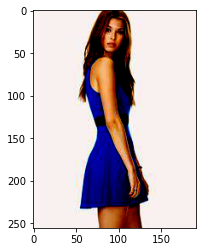

In [50]:
index = 4778
plt.imshow(ds[index]['src_image'])
ds.df.iloc[index]

In [51]:
ds.map_df.loc[ds.df.iloc[index]['from']]

Unnamed: 0                                         77
styles            WOMEN/Dresses/id_00000481/04/2_side
pose              WOMEN/Dresses/id_00000481/04_2_side
text          WOMEN-Dresses-id_00000481-04_2_side.jpg
Name: WOMEN/Dresses/id_00000481/04_2_side.jpg, dtype: object

In [52]:
draw_styles(ds[index]['styles'])

NameError: name 'draw_styles' is not defined

In [53]:
text_styles = [
    "Alice's face", # face
    'long blonde hair', # hair
    '', # headwear
    '', # background
    'blue dress', # top
    'blue dress', # outer
    '', # bottom
    'white high heel', #shoes
    'a black watch', # accesories
]

#text_styles = ['','','','','','','','','']

In [68]:
device = 'cpu'
sample = ds[index]
print(sample['txt'])
sample['styles'] = text_styles

sample['txt'] = 'This woman wears a sleeveless tank top with pure color patterns and three-point shorts.She wears a belt. The tank top is with cotton fabric and it has a round neckline. The shorts are with cotton fabric and solid color patterns. This female is wearing socks in shoes. The person is wearing a ring on her finger. There is an accessory on her wrist.'

for k, v in sample.items():
    if type(v)==torch.Tensor:
        sample[k] = sample[k].unsqueeze(0).to(device)
    else:
        sample[k] = [sample[k]]

This woman wears a sleeveless tank top with pure color patterns and three-point shorts. The tank top is with cotton fabric and it has a round neckline. The shorts are with cotton fabric and solid color patterns. This female is wearing socks in shoes. The person is wearing a ring on her finger. There is an accessory on her wrist.


Plotting: Switched to EMA weights
Data shape for DDIM sampling is (1, 4, 32, 24), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:04<00:00, 40.95it/s]


Plotting: Restored training weights
logs/2023-01-31T02-39-11_inshop_lip_clip/results/samples/4778.jpg
ssim: 0.83105946402511


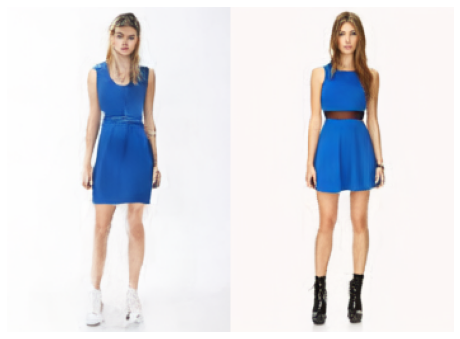

In [85]:
log = generate(model, sample, 200)

sample = T.CenterCrop(size=(256, 176))(Image.fromarray(np.uint8(log['samples'][0]*255)))

image_file = str(result_root/f'samples/{index}.jpg')
print(image_file)
gt = T.CenterCrop(size=(256, 176))(Image.fromarray(np.uint8(log['reconstruction'][0]*255)))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.imshow(np.hstack([sample, gt]))
print('ssim:',ssim(np.array(gt), np.array(sample), data_range=255, multichannel=True))


Plotting: Switched to EMA weights
Data shape for DDIM sampling is (1, 4, 32, 24), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:04<00:00, 41.54it/s]


Plotting: Restored training weights
logs/2023-01-31T02-39-11_inshop_lip_clip/results/samples/4778.jpg
ssim: 0.8027033215067293


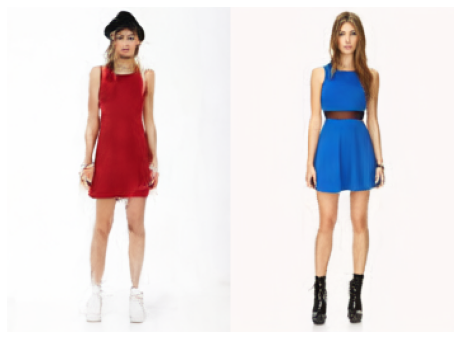

In [64]:
log = generate(model, sample, 200)

sample = T.CenterCrop(size=(256, 176))(Image.fromarray(np.uint8(log['samples'][0]*255)))

image_file = str(result_root/f'samples/{index}.jpg')
print(image_file)
gt = T.CenterCrop(size=(256, 176))(Image.fromarray(np.uint8(log['reconstruction'][0]*255)))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.imshow(np.hstack([sample, gt]))
print('ssim:',ssim(np.array(gt), np.array(sample), data_range=255, multichannel=True))


In [19]:
#sample.save(image_file)

In [84]:
log.keys()

dict_keys(['inputs', 'reconstruction', 'samples'])

In [35]:
ds[index]['image'].unsqueeze(0).shape

torch.Size([1, 256, 192, 3])

In [23]:
class Sampler:
    def __init__(self, opt, model, batch_size=1):
        self.config = OmegaConf.load(opt.config)
        self.cond_image_keys = self.config.lightning.callbacks.image_logger.params.log_cond_keys
        self.model = model#load_model_from_config(self.config, f"{opt.ckpt}").to('cuda:1')
        self.model.eval()
        
        if batch_size:
            self.config['data']['params']['batch_size'] = batch_size

        data = instantiate_from_config(self.config['data'])
        data.prepare_data()
        data.setup()

        self.dl = iter(data.val_dataloader())
        
    def get_data(self):
        return next(self.dl)
        
    def generate(self, batch, fixes={}, ddim_steps=200, seed=None, plot_denoise_rows=False, 
                    plot_progressive_rows=False, log_every_t=10):
        local_batch = deepcopy(batch)
        for key, value in fixes.items():
            repeat_n = len(local_batch[key])
            x = local_batch[key]
            if type(x) == list:
                if type(value) == str:
                    local_batch[key] = [value] * repeat_n
                elif type(x[value]) == int:
                    local_batch[key] = [x[value]] * repeat_n
                else:
                    raise ValueError
            else:
                dim_n = len(x.shape)-1
                local_batch[key] = x[value].repeat(repeat_n, *[1]*dim_n)

        #def run(batch):
        with torch.no_grad():
            images = self.model.log_images(local_batch, ddim_steps=ddim_steps, inpaint=False, seed=seed,
                                           plot_denoise_rows=plot_denoise_rows, 
                                           plot_progressive_rows=plot_progressive_rows,
                                           log_every_t=log_every_t)
        clamp = True
        k = 'samples'

        if isinstance(images[k], torch.Tensor):
            images[k] = images[k].detach().cpu()
            if clamp:
                images[k] = torch.clamp(images[k], -1., 1.)
            images[k] = rearrange(images[k].detach().cpu().numpy(),'b c h w -> b h w c' ) *0.5 + 0.5

        cond_1_image = local_batch[self.cond_image_keys[0]].numpy()*0.5+0.5
        #cond_2_image = local_batch[self.cond_image_keys[1]].numpy()*0.5+0.5
        #b, h, w, c = cond_2_image.shape
        #cond_1_image[:,:h,:w] = cond_2_image
        concat_images = np.concatenate((cond_1_image, images['samples']), axis=2)
        return concat_images, images
    


In [24]:

sampler = Sampler(opt)

Loading model from logs/2022-12-22T00-16-09_deepfashion_mm_style/checkpoints/last.ckpt
Global Step: 80205
LatentDiffusion: Running in eps-prediction mode
DiffusionWrapper has 425.29 M params.
Keeping EMAs of 688.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Restored from models/first_stage_models/kl-f8-deepfashion/deepfashion_v1.ckpt


Some weights of the model checkpoint at openai/clip-vit-large-patch14 were not used when initializing CLIPTextModel: ['vision_model.encoder.layers.10.self_attn.out_proj.bias', 'vision_model.encoder.layers.5.self_attn.k_proj.bias', 'vision_model.encoder.layers.17.mlp.fc1.weight', 'vision_model.encoder.layers.2.self_attn.v_proj.weight', 'vision_model.encoder.layers.15.layer_norm1.weight', 'vision_model.encoder.layers.9.mlp.fc2.bias', 'vision_model.encoder.layers.4.mlp.fc2.bias', 'vision_model.encoder.layers.20.self_attn.v_proj.weight', 'vision_model.encoder.layers.9.mlp.fc1.bias', 'vision_model.encoder.layers.14.self_attn.k_proj.weight', 'vision_model.encoder.layers.6.layer_norm2.bias', 'vision_model.encoder.layers.5.layer_norm1.bias', 'vision_model.encoder.layers.0.self_attn.q_proj.weight', 'vision_model.encoder.layers.21.self_attn.v_proj.bias', 'vision_model.encoder.layers.13.mlp.fc2.bias', 'vision_model.encoder.layers.5.mlp.fc2.weight', 'vision_model.encoder.layers.13.self_attn.q_proj

# Sampling

In [25]:
fixes = {}
#fixes = {'smpl':4, 'smpl_image':4}
#fixes = {'txt': 'the woman is wearing red multi-color jacket'}


batch_1 = sampler.get_data()
#batch_2 = sampler.get_data()
#fixes = {'txt':'the woman is wearing navy blue dress'}
#fixes = {'face_image':1, 'face_embed':1, 'txt':'the woman is wearing navy blue dress'}
images_1, _ = sampler.generate(batch_1, fixes)


Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 24), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:10<00:00, 18.93it/s]


Plotting: Restored training weights


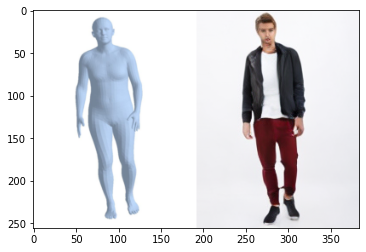

In [28]:
plt.imshow(images_1[0])

In [45]:
fixes = {}
#fixes = {'smpl':4, 'smpl_image':4}
#fixes = {'txt': 'the woman is wearing red multi-color jacket'}


batch_1 = sampler.get_data()
batch_2 = sampler.get_data()
batch_3 = deepcopy(batch_1)

#fixes = {'face_image':0, 'face_embed':0}
for k in ['styles']:
    batch_3[k][:,2:] = batch_2[k][:,2:]


Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 24), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:10<00:00, 18.79it/s]


Plotting: Restored training weights
Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 24), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:10<00:00, 18.62it/s]


Plotting: Restored training weights
Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 24), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:10<00:00, 18.56it/s]


Plotting: Restored training weights


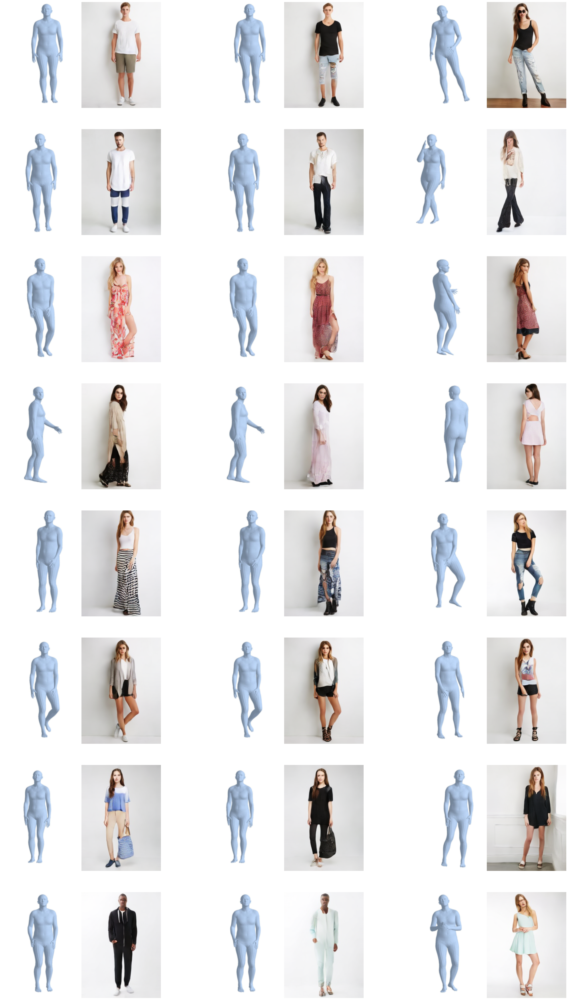

In [47]:
fixes = {}
images_1, all_images_1 = sampler.generate(batch_1, fixes)
images_2, all_images_2 = sampler.generate(batch_2, fixes)
images_3, all_images_3 = sampler.generate(batch_3, fixes)

images = [images_1, images_3, images_2]
cols = 3
rows = len(images[0])

indices = [i for i in range(rows)]
#indices = [5]
rows = len(indices)
f, axarr = plt.subplots(rows, cols)
f.set_figheight(rows*8)
f.set_figwidth(cols*12)

#for i in range(rows):
for i, row in enumerate(indices):
    for j in range(cols):
        if rows == 1:
            ax = axarr[j]
        else:
            ax = axarr[i, j]
        
        #axarr[i, j].imshow(Image.open(pose_paths[index]))
        ax.imshow(images[j][row])
        ax.axis('off')
        title = fixes.get('txt', batch_1['txt'][row])
        #ax.set_title(title)
    #index += 1


# Interpolation

In [8]:
def repeat_features(batch, fixes):
    local_batch = deepcopy(batch)
    for key, value in fixes.items():
        repeat_n = len(local_batch[key])
        x = local_batch[key]
        if type(x) == list:
            if type(value) == str:
                local_batch[key] = [value] * repeat_n
            elif type(x[value]) == int:
                local_batch[key] = [x[value]] * repeat_n
            else:
                raise ValueError
        else:
            dim_n = len(x.shape)-1
            local_batch[key] = x[value].repeat(repeat_n, *[1]*dim_n)
    return local_batch

In [9]:
batch_1 = sampler.get_data()
batch_3 = deepcopy(batch_1)
batch_2 = sampler.get_data()
for k in ['face_image', 'face_embed', 'txt']:
    batch_2[k] = deepcopy(batch_1[k])
alpha = 0.5
batch_3['smpl'] = alpha * batch_1['smpl'] + (1 - alpha) * batch_2['smpl']

for k in ['smpl_image']:
    batch_3[k] = torch.zeros_like(batch_3[k])


Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 32), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|███████████████████████████| 200/200 [00:13<00:00, 15.01it/s]


Plotting: Restored training weights


100%|███████████████████████████████████████████| 22/22 [00:04<00:00,  5.38it/s]


Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 32), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|███████████████████████████| 200/200 [00:13<00:00, 14.79it/s]


Plotting: Restored training weights
Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 32), eta 1.0
Running DDIM Sampling with 200 timesteps


DDIM Sampler: 100%|███████████████████████████| 200/200 [00:13<00:00, 14.68it/s]


Plotting: Restored training weights


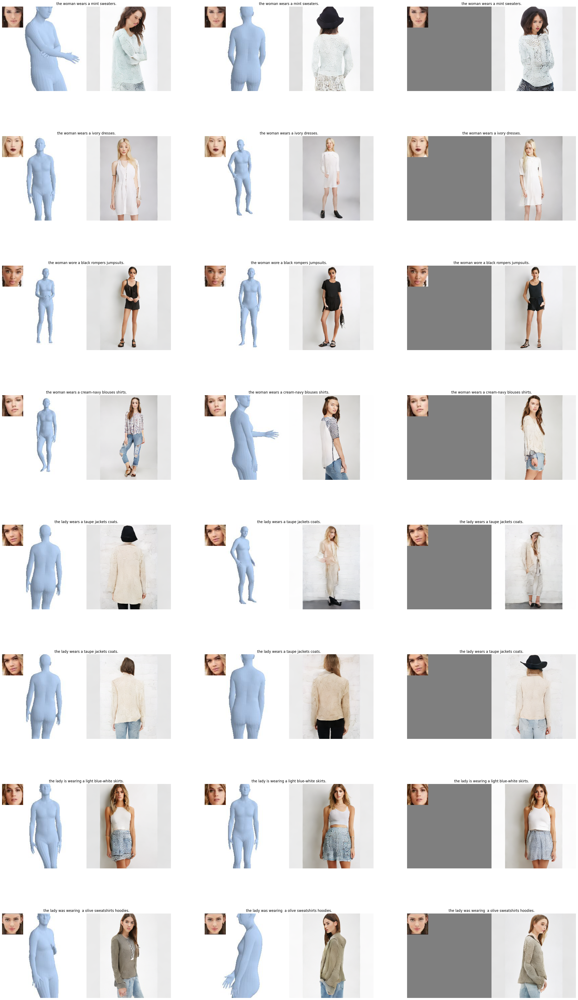

In [10]:
fixes = {}
images_1, all_images_1 = sampler.generate(batch_1, fixes, plot_denoise_rows=True)
images_2, all_images_2 = sampler.generate(batch_2, fixes)
images_3, all_images_3 = sampler.generate(batch_3, fixes)

images = [images_1, images_2, images_3]
cols = 3
rows = len(images[0])

indices = [i for i in range(rows)]
#indices = [5]
rows = len(indices)
f, axarr = plt.subplots(rows, cols)
f.set_figheight(rows*8)
f.set_figwidth(cols*12)

#for i in range(rows):
for i, row in enumerate(indices):
    for j in range(cols):
        if rows == 1:
            ax = axarr[j]
        else:
            ax = axarr[i, j]
        
        #axarr[i, j].imshow(Image.open(pose_paths[index]))
        ax.imshow(images[j][row])
        ax.axis('off')
        title = fixes.get('txt', batch_1['txt'][row])
        ax.set_title(title)
    #index += 1


# More interpolation

In [11]:
def get_item(batch, index):
    new_dict = dict()
    for k, v in batch.items():
        if type(v) == torch.Tensor:
            new_dict[k] = torch.unsqueeze(v[index], 0)
        elif type(v) == list:
            new_dict[k] = [v[index]]
        else:
            raise "Unimplemented"
    return new_dict

In [12]:
index = 7
start_sample = get_item(batch_1, index)
stop_sample = get_item(batch_2, index)

num_steps = 8
alphas = torch.Tensor(np.linspace(0, 1, num_steps).astype(np.float32))
alphas = alphas.view(-1, 1, 1)

In [13]:
text_prompt = ['the woman is wearing a white tee tanks and blue short']

In [14]:
poses = stop_sample['smpl'] * alphas + start_sample['smpl'] * (1 - alphas)
inter_batch = dict()

inter_batch['smpl'] = poses
inter_batch['txt'] = text_prompt * num_steps
inter_batch['image'] = start_sample['image'].repeat(num_steps, 1, 1, 1) 
inter_batch['face_image'] = start_sample['face_image'].repeat(num_steps, 1, 1, 1) 
inter_batch['face_embed'] = start_sample['face_embed'].repeat(num_steps, 1, 1) 

shapes = list(start_sample['smpl_image'].shape)
shapes[0] = num_steps
inter_batch['smpl_image'] = torch.zeros(shapes)
inter_batch['smpl_image'][0] = start_sample['smpl_image']
inter_batch['smpl_image'][-1] = stop_sample['smpl_image']

In [22]:
inter_images, all_images = sampler.generate(inter_batch, seed=None, plot_denoise_rows=True, \
                                            log_every_t=50, ddim_steps=500)

Plotting: Switched to EMA weights
Data shape for DDIM sampling is (8, 4, 32, 32), eta 1.0
Running DDIM Sampling with 500 timesteps


DDIM Sampler: 100%|███████████████████████████| 500/500 [00:33<00:00, 14.88it/s]


Plotting: Restored training weights


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  5.85it/s]


(-0.5, 2559.5, 255.5, -0.5)

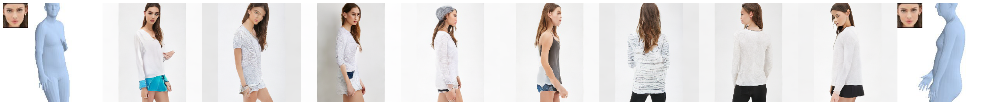

In [23]:
concat_image = inter_images[0]
for i in range(1, len(inter_images)-1):
    concat_image = np.concatenate((concat_image, inter_images[i][:,-256:,:]), 1)
concat_image = np.concatenate((concat_image, inter_images[-1][:,-256:], inter_images[-1][:,:256]), 1)

f, axarr = plt.subplots(1, 1)
f.set_figheight(8)
f.set_figwidth(40)

axarr.imshow(concat_image)
axarr.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


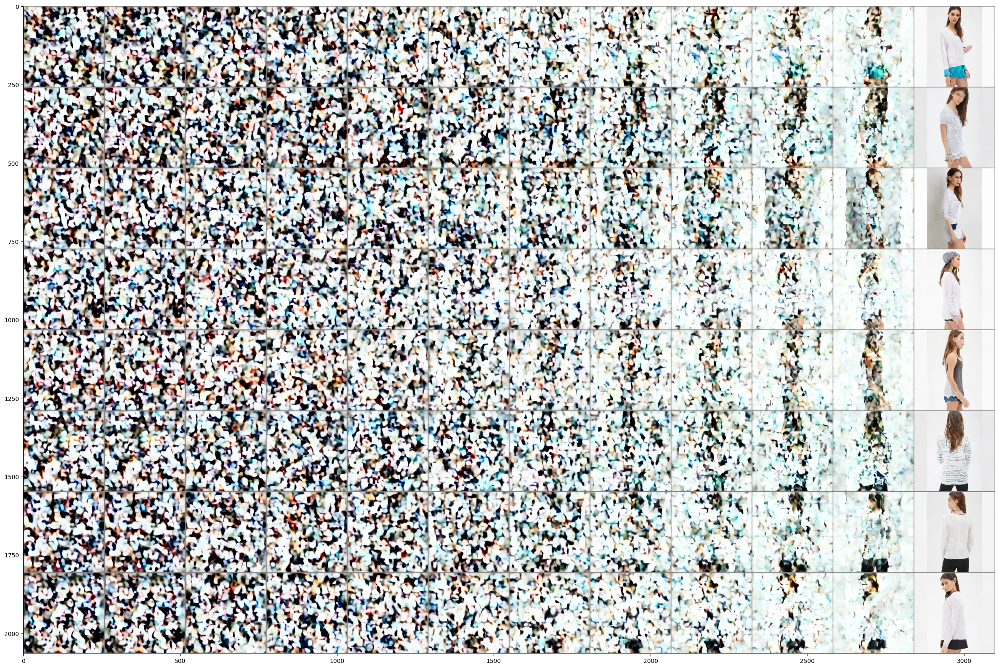

In [24]:
x = rearrange(all_images['denoise_row'].detach().cpu().numpy(),'c h w -> h w c' ) *0.5 + 0.5
plt.figure(figsize=(200,20))
plt.imshow(x)

In [19]:
all_images.keys()

dict_keys(['inputs', 'reconstruction', 'diffusion_row', 'samples', 'denoise_row'])

In [20]:
all_images['denoise_row'].shape

torch.Size([3, 2066, 1034])

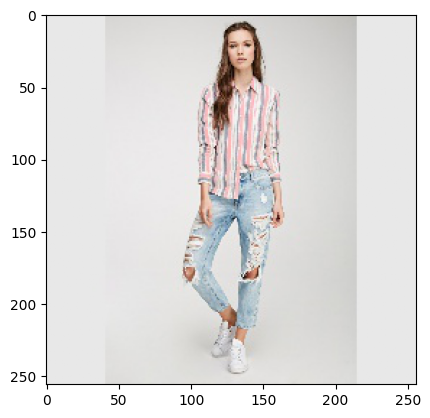

In [48]:
x = rearrange(all_images['inputs'][3].detach().cpu().numpy(),'c h w -> h w c' ) *0.5 + 0.5
plt.imshow(x)

In [19]:
sampler.model.image_size

32

In [25]:
torch.randn((1,8,32,32)).repeat((4,1,1,1)).shape

torch.Size([4, 8, 32, 32])